In [ ]:
# Loading the zip folder from the url
!wget https://vis-www.cs.umass.edu/lfw/lfw.tgz

--2023-11-18 06:27:03--  https://vis-www.cs.umass.edu/lfw/lfw.tgz
Resolving vis-www.cs.umass.edu (vis-www.cs.umass.edu)... 128.119.244.95
Connecting to vis-www.cs.umass.edu (vis-www.cs.umass.edu)|128.119.244.95|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 180566744 (172M) [application/x-gzip]
Saving to: ‘lfw.tgz’

lfw.tgz             100%[===================>] 172.20M  36.6MB/s    in 5.0s    

2023-11-18 06:27:08 (34.5 MB/s) - ‘lfw.tgz’ saved [180566744/180566744]



In [ ]:
# Unpacking the tgz file
!tar -xvf lfw.tgz

Streaming output truncated to the last 5000 lines.
lfw/Luis_Sanchez/
lfw/Luis_Sanchez/Luis_Sanchez_0001.jpg
lfw/Juliette_Binoche/
lfw/Juliette_Binoche/Juliette_Binoche_0001.jpg
lfw/Joel_Todd/
lfw/Joel_Todd/Joel_Todd_0001.jpg
lfw/Allan_Wagner/
lfw/Allan_Wagner/Allan_Wagner_0001.jpg
lfw/Alejandro_Fernandez/
lfw/Alejandro_Fernandez/Alejandro_Fernandez_0001.jpg
lfw/Guillaume_Depardieu/
lfw/Guillaume_Depardieu/Guillaume_Depardieu_0001.jpg
lfw/Delphine_Chuillot/
lfw/Delphine_Chuillot/Delphine_Chuillot_0001.jpg
lfw/Paul_LeClerc/
lfw/Paul_LeClerc/Paul_LeClerc_0001.jpg
lfw/Eddie_Jordan/
lfw/Eddie_Jordan/Eddie_Jordan_0001.jpg
lfw/Lionel_Richie/
lfw/Lionel_Richie/Lionel_Richie_0001.jpg
lfw/Lionel_Richie/Lionel_Richie_0002.jpg
lfw/Jose_Viegas_Filho/
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0001.jpg
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0002.jpg
lfw/Roger_Mahony/
lfw/Roger_Mahony/Roger_Mahony_0001.jpg
lfw/Clay_Aiken/
lfw/Clay_Aiken/Clay_Aiken_0001.jpg
lfw/Clay_Aiken/Clay_Aiken_0002.jpg
lfw/Clay_Ai

In [ ]:
#Importing os for working with parsing
import os

# Get the path to the dataset directory.
dataset_dir = '/content/lfw'

#defining a function for counting the number of folders with multiple images
def count_people_with_multiple_images(dataset_dir):
  """Counts the number of people in the given dataset directory who have more than one image.

  Args:
    dataset_dir: The directory containing the dataset.

  Returns:
    The number of people in the dataset who have more than one image.
  """

  # Create a dictionary to store the number of images for each person.
  person_counts = {}

  # Iterate over all the folders in the dataset directory.
  for folder in os.listdir(dataset_dir):
    # Get the person's name from the folder name.
    person_name = folder

    # Count the number of images in the person's folder.
    num_images = 0
    for file in os.listdir(os.path.join(dataset_dir, folder)):
      # Accumulating the number of images present in the folder
      num_images += 1

    # If the person has more than one image, add them to the dictionary.
    if num_images > 1:
      person_counts[person_name] = num_images

  # Count the number of people with more than one image.
  num_people_with_multiple_images = 0
  #Running a loop for counting the total number of folders with multiple images
  for person_name in person_counts:
    num_people_with_multiple_images += 1

  return num_people_with_multiple_images, person_counts


# Count the number of people with multiple images.
num_people_with_multiple_images, person_counts = count_people_with_multiple_images(dataset_dir)

# Print the number of people with multiple images.
print('Number of people with multiple images:', num_people_with_multiple_images)

Number of people with multiple images: 1680


In [ ]:
#importing random for shuffling the dataset
import random

# Create a list of all the people in the LFW dataset.
people = list(person_counts.keys())

# Randomly shuffle the list of people.
random.shuffle(people)
# setting the splitting point
train_num = int(0.8 * len(people))
# Initializing two dict for storing the name and number
train_dict, test_dict = {}, {}

# Running two loops for storing the number of files for their corresponding keys
for folder in people[:train_num]:
  num_files = len(os.listdir(os.path.join(dataset_dir, folder)))
  train_dict[folder] = num_files # Storing the key value pair for training dict

for folder in people[train_num:]:
  num_files = len(os.listdir(os.path.join(dataset_dir, folder)))
  test_dict[folder] = num_files # Storing the key value pair for testing dict

# # Save the training and test sets to your Google Drive.
import pickle
#Storing the dict as a pkl file for safety
with open('/content/lfw_train.pkl', 'wb') as f:
    pickle.dump(train_dict, f)

with open('/content/lfw_test.pkl', 'wb') as f:
    pickle.dump(test_dict, f)
# Printing the length for sanity check
print("Length of training list:", len(train_dict))
print("Length of testing list :", len(test_dict))

Length of training list: 1344
Length of testing list : 336


## Creating triplets

Here, we define triplets while addressing the images from the main folder only. This way we keep the ram in check and have a more clean way of addressing the images.

In [ ]:
# Defining the function
def create_triplets(directory, folder_list, max_files=9):
  triplets = [] #Initializing triplet list
  folder = list(folder_list.keys()) #loading all the keys (names) from the dataset

  # Running a loop for creating the triplets folder by folder
  for fil in folder:
    #Initialzing the path for datset directory and the current folder
    path = os.path.join(directory, fil)
    #Loading files to the max amount of images which we will parse over for one
    # pertucular person
    files = list(os.listdir(path))[:max_files]

    num_files = len(files) # Total amount of images in the file
    for i in range(1, num_files+1): # A loop over all the names
      for j in range(i+1, num_files+1):
        if i <= 9: # Conditional statement for double digit images
          anchor = (fil, fil + f"_000{i}.jpg")
        else:
          anchor = (fil, fil + f"_00{i}.jpg")
        if j <= 9: # We choose another image from the same person's folder
          positive = (fil, fil + f"_000{j}.jpg")
        else:# Again the conditional statement for double digit images
          positive = (fil, fil + f"_00{j}.jpg")

        neg_folder = fil # initialize negative folder to be the same as anchor folder
        while neg_folder == fil: # Running a while loop until we find another person's folder
          neg_folder = random.choice(folder)
        neg_file = random.randint(1, folder_list[neg_folder]) # Storing the other folder as negfile
        if neg_file <=9: # Conditional statement for making the triplet's negative
          negative = (neg_folder, neg_folder + f"_000{neg_file}.jpg")
        else:
          negative = (neg_folder, neg_folder + f"_00{neg_file}.jpg")

        triplets.append((anchor, positive, negative)) # Appending the newly created triplet in the pre-defined variable
  random.shuffle(triplets) # Random shuffle for more unbiased dataset
  return triplets

In [ ]:
train_triplet = create_triplets(dataset_dir, train_dict) # Initializing train triplet
test_triplet = create_triplets(dataset_dir, test_dict) # Initializing test triplet
print("Number of training triplets:", len(train_triplet)) # Printing the train triplets created
print("Number of testing triplets :", len(test_triplet)) # Pringting the test triplets created

print("\nExamples of triplets:") # Showing some examples of the triplets created for sanity check
for i in range(5):
  print(train_triplet[i], "\n") # Each line for one triplet

Number of training triplets: 10709
Number of testing triplets : 2377

Examples of triplets:
(('Andy_Roddick', 'Andy_Roddick_0003.jpg'), ('Andy_Roddick', 'Andy_Roddick_0007.jpg'), ('Kim_Jin-sun', 'Kim_Jin-sun_0002.jpg')) 

(('Ben_Affleck', 'Ben_Affleck_0006.jpg'), ('Ben_Affleck', 'Ben_Affleck_0007.jpg'), ('Richard_Virenque', 'Richard_Virenque_0008.jpg')) 

(('Clara_Harris', 'Clara_Harris_0001.jpg'), ('Clara_Harris', 'Clara_Harris_0003.jpg'), ('Robert_Ehrlich', 'Robert_Ehrlich_0002.jpg')) 

(('Sheryl_Crow', 'Sheryl_Crow_0004.jpg'), ('Sheryl_Crow', 'Sheryl_Crow_0006.jpg'), ('Damon_van_Dam', 'Damon_van_Dam_0001.jpg')) 

(('Kurt_Russell', 'Kurt_Russell_0001.jpg'), ('Kurt_Russell', 'Kurt_Russell_0002.jpg'), ('Peter_Hillary', 'Peter_Hillary_0001.jpg')) 



## Adding preprocessing for our pretrained model.

The preprocessing steps applied by the `preprocess_input` function are:

- Convert the image from RGB to BGR color format.
- Subtract the mean RGB values of the ImageNet dataset from each channel of the image.
- Scale the image values to the range [-1, 1].

In [ ]:
# Inspired from the reference I will be using inception_v3 imagenet as the backbone of the neural networks in the siamese
from tensorflow.keras.applications.inception_v3 import preprocess_input # Importing the preprocessing unit from the tensorflow library
                                                                        # For making the input compatible with inception net

Defining a code for reading image from folder and plotting all the images within in in horizontal manner.

In [ ]:
from PIL import Image # For reading the images
import numpy as np
import random
import scipy.ndimage as ndi # For image augmentation



# Defining a folder which will show all the images in the folder
def folder_show(folder_path):
  """Shows all the images in the folder."""

  images = [] # Initializing a variable images
  for filename in os.listdir('lfw/'+folder_path): # Parsing over the images in the folder (folder_path)
    if filename.endswith(".jpg") or filename.endswith(".png"): # If the content is .jpg or .png (In case it is present)
      # we will append that image location to the variable images
      images.append(Image.open(os.path.join('lfw/'+folder_path, filename)))
  #Extracting the width and heights of the images
  widths, heights = zip(*(i.size for i in images))
  # Using the heights to understand create a concatenated image for the folder
  total_width = sum(widths)
  max_height = max(heights)
  # Initializing the new_im which will contain all the images in the folder
  new_im = Image.new('RGB', (total_width, max_height))
  # Initializing this offset which will be used to add new images
  x_offset = 0
  for im in images: # Parsing over all the images stored in the variable images
    new_im.paste(im, (x_offset, 0)) # Pasting the images according to the offset
    x_offset += im.width # Incrementing the pointer (offset)

  return new_im # Returning the image (new_im)

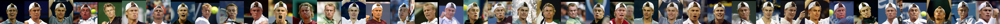

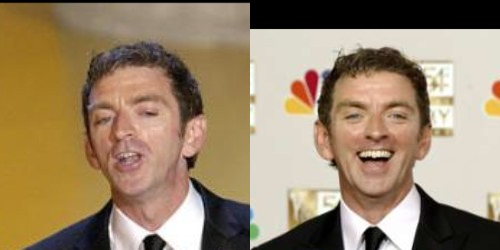

In [ ]:
from IPython.display import display # For displaying
for i in range(2):
  display(folder_show(people[i+30])) # Example for the function for sanity check

In [ ]:
import scipy # Will be used in the function defined below
def img_augmentation(img):
	if random.random()>0.7: # Randomness for implementing augmentation

		h, w, c= np.shape(img) # Extracting the parameters of the image
		# translation
		if random.random() > 0.5: # Again using randomness if we want to apply shift to the image or not
			# Here in both u and v direction we apply translation depending on the random variable
			img = scipy.ndimage.shift(img, (int(random.random() * 20 - 10), int(random.random() * 20 - 10), 0))
		# rotation
		if random.random() > 0.5:
			# Similar to before we will apply rotation which making it so that most of the time the head is oriented in realistic manner
			img = scipy.ndimage.rotate(img, random.random() * 60 - 30)

	 # Extracting the features of the augmented image which we will use to pad the original image
		h_c, w_c = img.shape[:2]
		if h_c > h:
			# Padding from both sides in vertical and horizontal
			top = int(h_c / 2 - h / 2)
			left = int(w_c / 2 - w / 2)
	 		# Generating the output image
			img_out = img[top: top + h, left: left + w]
		else:
			# In case we observe a zoom in effect
			pad_size = int((h - h_c) / 2)
			pads = ((pad_size, pad_size), (pad_size, pad_size), (0, 0)) # Defining the pad size
			# Generating the output image
			img_out = np.pad(np.array(img), pads, 'constant', constant_values=0)
	else:
		img_out = img
	# print np.shape(img_out)
	return img_out


## Defining a image reader

Here, it reads the image from the anchor tuple from which we then convert the image to `"RGB"`. Which can be then preprocessed and fed to the model.

In [ ]:
import cv2
# We will use this function a lot below as this is responsible for reading the image from the location provided from the dataset
def read_image(addr):
  # Read the image file
  path = dataset_dir + "/" + addr[0] + "/" + addr[1]
  # Loading the image from the path
  img = cv2.imread(path)
  # Applying augmentation function on the image
  img = img_augmentation(img)

  # Returning the image
  return img

## Creating Batch Generator
Creating a **Batch-Generator** which converts the triplets passed into batches of face-data and **preprocesses** it before returning the data into seperate lists.

**Parameters**
- Batch_size: `Batch_size` of the data to return
- Preprocess: Whether to preprocess the data or not

In [ ]:
# This is our dataloader for the model
def get_batch(triplet_list, batch_size=256, preprocess=True):
    batch_steps = len(triplet_list)//batch_size # Defines the batch step according to the data provided and batch size

    # creating batches for each step
    for i in range(batch_steps+1):
        # Since we will make a triplet siamese will make three different list
        anchor   = []
        positive = []
        negative = []
        # Defining a new pointer according to the current batch
        j = i*batch_size
        while j<(i+1)*batch_size and j<len(triplet_list):
            a, p, n = triplet_list[j] # Loading all three file location in three variables
            anchor.append(read_image(a)) # Reading the anchor and appending it to the list for the same
            positive.append(read_image(p)) # Reading the positive and appending it to the list for the same
            negative.append(read_image(n)) # Reading the negative and appending it to the list for the same
            j+=1

        # Converting the lists to numpy arrays
        anchor = np.array(anchor)
        positive = np.array(positive)
        negative = np.array(negative)

        # Conditional statement if not preprocessed we need to make the images compatible with the imagenet
        if preprocess:
            # Passing all the images through the preprocessing input for imagenet_v3
            anchor = preprocess_input(anchor)
            positive = preprocess_input(positive)
            negative = preprocess_input(negative)
        # We use yield here since we will be enumerating over all the batches (works similar to return but can be looped over)
        yield ([anchor, positive, negative])


The `yield` keyword in Python is used to create a generator function. A generator function is a type of function that can be used to iterate over a sequence of values without having to store the entire sequence in memory.

This is done by using the `yield` keyword to return each value in the sequence one at a time.

## Plotting the data
Plotting the data generated from the `get_batch()` function that we just created.

(250, 750, 3)


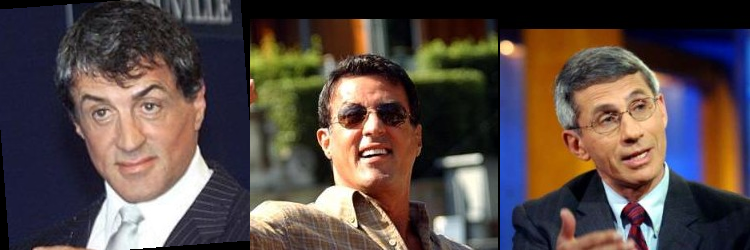

(250, 750, 3)


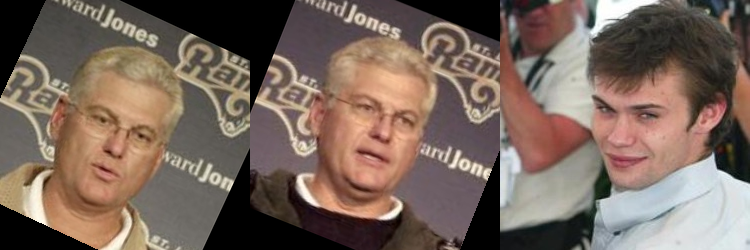

(250, 750, 3)


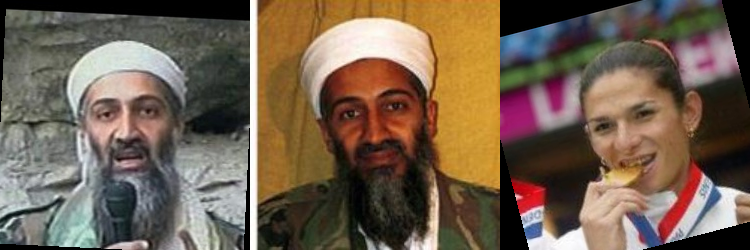

(250, 750, 3)


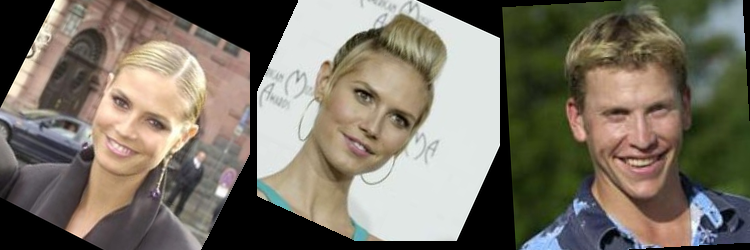

In [ ]:
from google.colab.patches import cv2_imshow # Since google colab
# Defining another function for showing images which also includes the image augmentation function
# Also here the triplets will be the output where the imput will be the yield from get_batch
def im_show(a, p, n):
    images = [] # Defining a list of images
    images.append(img_augmentation(read_image(a))) # appending the augmented anchor image
    images.append(img_augmentation(read_image(p))) # appending the augmented postive image
    images.append(img_augmentation(read_image(n))) # appending the augmented negative image
    # as before extracting the widths and heights
    widths, heights = zip(*(i.shape[:2] for i in images))
    # Defining the parameters for the final image
    total_width = sum(widths)
    max_height = max(heights)
    # Initializng the final image
    new_im = np.zeros((max_height, total_width, 3), dtype=np.uint8)
    # Similar to the function defined before
    x_offset = 0
    for im in images:
        new_im[:, x_offset:x_offset+im.shape[1], :] = im
        x_offset += im.shape[1]

    return new_im
# Looping over Four random samples and printing their shapes for sanity check
for i in range(4):
    a, p, n = train_triplet[i + 59]
    img = im_show(a, p, n)
    print(img.shape)
    cv2_imshow(img)

As we can see the output from image augmentation is doing both shift and rotation of the image that too randomly which should take care of overfitting over the dataset to an extent.

## Creating the model

In **Siamese network** we don't classify images at the start rather we extract their features which we then use to measure the closeness between two images.

In [ ]:
#For defining the model
import tensorflow as tf
from tensorflow.keras import backend, layers, metrics
# For the model
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
from tensorflow.keras.layers import Lambda
from tensorflow.keras.applications import Xception
from tensorflow.keras.models import Model, Sequential
# For the checking the model
from tensorflow.keras.utils import plot_model
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

### Encoding
The encoder is responsible for converting the passed images into their feature vector. I am using a pretrained model, which will be **resnet 34**.

The Model is connected to **Fully Connected** (Dense) layers and the last layer normalises the data using **L2** Normalisation

In [ ]:
# Creating a function which fetches an encoder according to the input shape
def get_encoder(input_shape):
    """ Returns the image encoding model """
    # As mentioned before we will be using the pretrained imagenet (Xception_V3)
    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )
    # We will keep the last 27 layers as trainable as this lets the gradient flow nicely and train for the corresponding task
    for i in range(len(pretrained_model.layers)-27):
        pretrained_model.layers[i].trainable = False
    # The output layer that we have used on top of the image net
    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(), # Flatten the dimensions
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(), # Normalizing the batch
        layers.Dense(256, activation="relu"),
        layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)) # Using L2 regularization
    ], name="Encode_Model")
    return encode_model # Returning the encoder model

## Distance Layer

I will be using the following class to calculate the euclidean distance between two images and then using that as the output for the siamese network that we will be creating for now.

$$ Output = ||f(A) - f(P)||^{2}, ||f(A) - f(N)||^{2} $$

Where *f()* is the encorder which provides the feature of the image using the imagenet.

In [ ]:
class DistanceLayer(layers.Layer):
    # A layer to compute ‖f(A) - f(P)‖² and ‖f(A) - f(N)‖²
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    # When calleed it will provide a tuple which contains the eucledian distance between anchor and positive, negative respectively
    def call(self, anchor, positive, negative):
        ap_distance = tf.reduce_sum(tf.square(anchor - positive), -1)
        an_distance = tf.reduce_sum(tf.square(anchor - negative), -1)
        return (ap_distance, an_distance)

# Defining a function which fetches a siamese network we will be using this function for generating the neural network for our siamese
def get_siamese_network(input_shape = (250, 250, 3)):
    encoder = get_encoder(input_shape) # Initializing the enoder

    # Input Layers for the images
    anchor_input   = layers.Input(input_shape, name="Anchor_Input")
    positive_input = layers.Input(input_shape, name="Positive_Input")
    negative_input = layers.Input(input_shape, name="Negative_Input")

    ## Generate the encodings (feature vectors) for the images
    encoded_a = encoder(anchor_input)
    encoded_p = encoder(positive_input)
    encoded_n = encoder(negative_input)

    # A layer to compute ‖f(A) - f(P)‖² and ‖f(A) - f(N)‖²
    distances = DistanceLayer()(
        encoder(anchor_input),
        encoder(positive_input),
        encoder(negative_input)
    )

    # Creating the Model
    siamese_network = Model(
        inputs  = [anchor_input, positive_input, negative_input],
        outputs = distances,
        name = "Siamese_Network"
    )
    return siamese_network
# Initializing a siamese network
siamese_network = get_siamese_network()
siamese_network.summary() # Printing the network

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

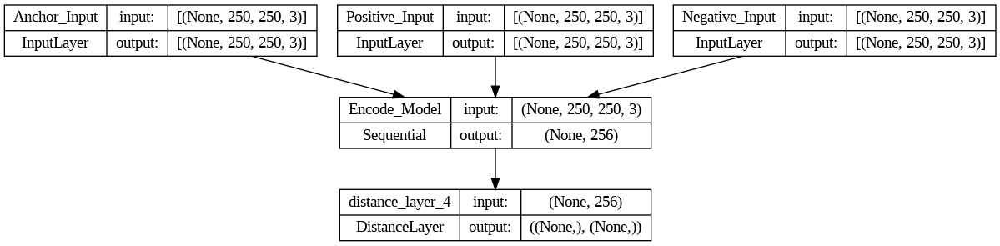

In [ ]:
# Plotting the model
plot_model(siamese_network, show_shapes=True, show_layer_names=True)

### Creating the main model
This model we will be using for the training loop while defining the loss function and using Adam optimization on this triplet siamese network.

Triplet loss function:
$$Loss = \Sigma_{i=1}^{N}[||f_{i}^{a}-f_{i}^{p}||_{2}^{2} - ||f_{i}^{a} - f_{i}^{b}||_{2}^{2} + \alpha]_{+}$$

In [ ]:
class SiameseModel(Model):
    # Builds a Siamese model based on a base-model
    def __init__(self, siamese_network, margin=1.0):
        super(SiameseModel, self).__init__()
        # Defines a margin (threshold) for defining if the image is of the same person or not
        self.margin = margin
        # Using the siamese network
        self.siamese_network = siamese_network
        # Initializing mean loss tracker
        self.loss_tracker = metrics.Mean(name="loss")

    def call(self, inputs):
      # it returns the output from the siamese network (distances)
        return self.siamese_network(inputs)

    def train_step(self, data):
        # GradientTape get the gradients when we compute loss, and uses them to update the weights
        with tf.GradientTape() as tape:
            loss = self._compute_loss(data)
        # using gradient tape for storing gradient in a variable
        gradients = tape.gradient(loss, self.siamese_network.trainable_weights)
        # Using the optimizer to apply gradient on the trainable weights
        self.optimizer.apply_gradients(zip(gradients, self.siamese_network.trainable_weights))
        # Updating the loss state
        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()} # Returns a string which contains the result of the loss tracker

    def test_step(self, data):
        # stores the loss over the test dataset
        loss = self._compute_loss(data)

        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()} # Returns the loss on the test dataset

    def _compute_loss(self, data):
        # Get the two distances from the network, then compute the triplet loss
        ap_distance, an_distance = self.siamese_network(data)
        # Implementing the triplet loss as mentioned above this code block
        loss = tf.maximum(ap_distance - an_distance + self.margin, 0.0)
        return loss

    @property
    def metrics(self):
        # We need to list our metrics so the reset_states() can be called automatically.
        return [self.loss_tracker]

In [ ]:
# Initializing the siamese model
siamese_model = SiameseModel(siamese_network)
# Initializing the optimizer
optimizer = Adam(learning_rate=1e-3, epsilon=1e-01)
# Compiling the model
siamese_model.compile(optimizer=optimizer)

### Training the model
Now by using the triplet batches that we created we will training the model. We will be printing the test and train loss along with every epoch to get an understanding of how the model is training.

In [ ]:
# Defining a function which test the triplets
def test_on_triplets(batch_size = 256):
  # Scores for both postive and negative of the triplet lists
    pos_scores, neg_scores = [], []
    # Enumerating over the batches
    for data in get_batch(test_triplet[1:50], batch_size=batch_size):
        prediction = siamese_model.predict(data)
          # After prediction have been made (distances)
        pos_scores += list(prediction[0])
        neg_scores += list(prediction[1])
    # Calculating if the distances were similar to the ground truth or not and converting that to accuracy
    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)
    # Printing the accuracy over test
    print(f"Accuracy on test = {accuracy:.5f}")
    return (accuracy)

In [ ]:
import time # For getting a sense of time in the model training

In [ ]:
# In case I want to save the weights
save_all = False
# The number of epochs for which the model would train
epochs = 20
# The size of each batch
batch_size = 8

# Initializing the max accuracy
max_acc = 0
# Initializing the lists for test and train loss/metric
train_loss = []
test_metrics = []

# Looping over for each epoch
for epoch in range(1, epochs+1):
    # Starting the timer
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss) # appending the loss in the list
    epoch_loss = sum(epoch_loss)/len(epoch_loss) # Taking the average loss over all the batches
    train_loss.append(epoch_loss) # appending the avg loss to the train_loss list

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on test data
    metric = test_on_triplets(batch_size=batch_size) # getting the accuracy on the validation dataset
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 29 sec)
Loss on train    = 0.84280
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.79592

EPOCH: 2 	 (Epoch done in 10 sec)
Loss on train    = 0.68051
1/1 [==============================] - 0s 35ms/step
Accuracy on test = 0.77551

EPOCH: 3 	 (Epoch done in 11 sec)
Loss on train    = 0.48841
1/1 [==============================] - 0s 50ms/step
Accuracy on test = 0.73469

EPOCH: 4 	 (Epoch done in 11 sec)
Loss on train    = 0.37351
1/1 [==============================] - 0s 43ms/step
Accuracy on test = 0.81633

EPOCH: 5 	 (Epoch done in 9 sec)
Loss on train    = 0.25231
1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.77551

EPOCH: 6 	 (Epoch done in 9 sec)
Loss on train    = 0.21012
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.83673

EPOCH: 7 	 (Epoch done in 10 sec)
Loss on train    = 0.13871
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.79592

EPOCH: 8 	 (Ep

## Implementing different regularizations


### L1 regularization
we change the final layer form L2 to L1.

In [ ]:
# We will be trying l1 normalization
def l1_normalize(x):
    return x / (tf.norm(x, ord=1, axis=1, keepdims=True) + 1e-8)

# Fetching the encoder for this model
def get_encoder(input_shape):
    """ Returns the image encoding model """

    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    for i in range(len(pretrained_model.layers)-27):
        pretrained_model.layers[i].trainable = False

    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        Lambda(l1_normalize)
    ], name="Encode_Model")
    return encode_model

In [ ]:
# Initializing the model again with L1 regularization
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

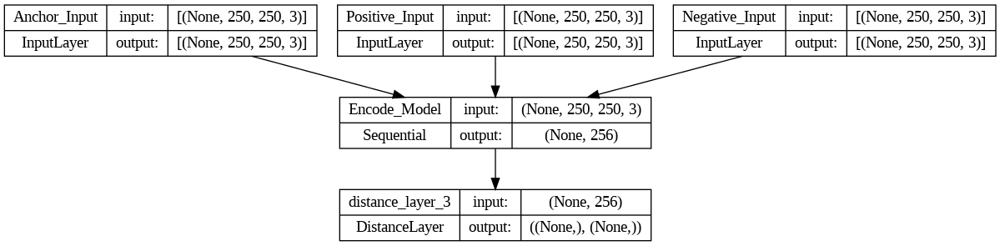

In [ ]:
#Plotting the model to show the changes
plot_model(siamese_network, show_shapes=True, show_layer_names=True)

In [ ]:
#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)
#Setting the optimizer with learning rate
optimizer = Adam(learning_rate=1e-3, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer) #Compiling the model

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 27 sec)
Loss on train    = 0.99762
1/1 [==============================] - 0s 36ms/step
Accuracy on test = 0.87755

EPOCH: 2 	 (Epoch done in 8 sec)
Loss on train    = 0.99768
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.77551

EPOCH: 3 	 (Epoch done in 8 sec)
Loss on train    = 0.99749
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.81633

EPOCH: 4 	 (Epoch done in 9 sec)
Loss on train    = 0.99767
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.83673

EPOCH: 5 	 (Epoch done in 10 sec)
Loss on train    = 0.99753
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.79592

EPOCH: 6 	 (Epoch done in 10 sec)
Loss on train    = 0.99729
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.79592

EPOCH: 7 	 (Epoch done in 10 sec)
Loss on train    = 0.99718
1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.79592

EPOCH: 8 	 (Epo

### Dropout Regularization
As before we change the last layer to a dropout layer. This should prevent overfitting.

In [ ]:
# Similar to before we will be initializing the encoder the only difference will be that the final regularization is dropout here
def get_encoder(input_shape):
    """ Returns the image encoding model """

    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    for i in range(len(pretrained_model.layers)-27):
        pretrained_model.layers[i].trainable = False

    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        layers.Dropout(0.03) # Adding dropout layer
    ], name="Encode_Model")
    return encode_model

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

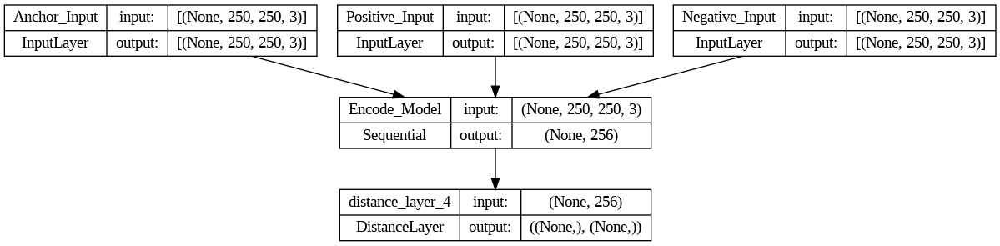

In [ ]:
#Plotting the model to show the changes
plot_model(siamese_network, show_shapes=True, show_layer_names=True)

In [ ]:
#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)
#Setting the optimizer with learning rate
optimizer = Adam(learning_rate=1e-3, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer) #Compiling the model

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 25 sec)
Loss on train    = 0.75852
1/1 [==============================] - 0s 47ms/step
Accuracy on test = 0.79592

EPOCH: 2 	 (Epoch done in 8 sec)
Loss on train    = 0.23561
1/1 [==============================] - 0s 45ms/step
Accuracy on test = 0.81633

EPOCH: 3 	 (Epoch done in 8 sec)
Loss on train    = 0.08858
1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.81633

EPOCH: 4 	 (Epoch done in 8 sec)
Loss on train    = 0.01539
1/1 [==============================] - 0s 36ms/step
Accuracy on test = 0.77551

EPOCH: 5 	 (Epoch done in 9 sec)
Loss on train    = 0.05050
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.85714

EPOCH: 6 	 (Epoch done in 11 sec)
Loss on train    = 0.05319
1/1 [==============================] - 0s 34ms/step
Accuracy on test = 0.81633

EPOCH: 7 	 (Epoch done in 9 sec)
Loss on train    = 0.02316
1/1 [==============================] - 0s 37ms/step
Accuracy on test = 0.81633

EPOCH: 8 	 (Epoch

In [ ]:
# setting the encorder with L2 regularization final layer
def get_encoder(input_shape):
    """ Returns the image encoding model """

    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    for i in range(len(pretrained_model.layers)-27):
        pretrained_model.layers[i].trainable = False

    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))
    ], name="Encode_Model")
    return encode_model

Here, We observe that L2 regularization is better than the other regularization that I used. Therefore we will be using L2 regularization for the final model.

The reasoning why L2 performs better is because it promotes non-zero weights and prevents extreme values. While L1 regularization tends to produce sparse weights and is not suitable for image extraction (Removes features). As for Dropout regularization, it randomly drops out unit in the network, which may reduce the network's capacity and stability.

This issue about dropout layers became more evident when I tried training the siamese model while using it. With epochs the loss starts increasing after a certain point. This led me to use L2 regularization

## Learning Rate Schedulers

### Step Decay
This scheduler reduces the learning rate by a certain factor after every few epochs.

In [ ]:
# We will be defining this step decay function which
class StepDecay(tf.keras.optimizers.schedules.LearningRateSchedule):

  # initializing steps, rate
  def __init__(self, initial_learning_rate, decay_steps, decay_rate):
    self.initial_learning_rate = initial_learning_rate
    self.decay_steps = decay_steps
    self.decay_rate = decay_rate
    self.global_step = 0
  # defining the call function for this class where it will decay the learning rate
  def __call__(self, step):
    self.global_step += 1
    if self.global_step % self.decay_steps == 0:
      self.initial_learning_rate *= self.decay_rate
    return self.initial_learning_rate

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)

# Create a step decay learning rate scheduler
step_decay_scheduler = StepDecay(initial_learning_rate=1e-3, decay_steps=20, decay_rate=0.01)

# Compile the model with the step decay learning rate scheduler
siamese_model.compile(optimizer=Adam(learning_rate=step_decay_scheduler), loss='mse')

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 26 sec)
Loss on train    = 0.86359
1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.73469

EPOCH: 2 	 (Epoch done in 8 sec)
Loss on train    = 0.66709
1/1 [==============================] - 0s 35ms/step
Accuracy on test = 0.79592

EPOCH: 3 	 (Epoch done in 10 sec)
Loss on train    = 0.57060
1/1 [==============================] - 0s 34ms/step
Accuracy on test = 0.75510

EPOCH: 4 	 (Epoch done in 9 sec)
Loss on train    = 0.59005
1/1 [==============================] - 0s 34ms/step
Accuracy on test = 0.71429

EPOCH: 5 	 (Epoch done in 11 sec)
Loss on train    = 0.76509
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.79592

EPOCH: 6 	 (Epoch done in 10 sec)
Loss on train    = 0.67805
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.67347

EPOCH: 7 	 (Epoch done in 11 sec)
Loss on train    = 0.47507
1/1 [==============================] - 0s 38ms/step
Accuracy on test = 0.73469

EPOCH: 8 	 (Ep

### Cosine decay
This scheduler reduces the learning rate in a cosine-like manner over time.

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)

# Create a cosine decay learning rate scheduler
cosine_decay_scheduler = tf.keras.optimizers.schedules.CosineDecay(initial_learning_rate=1e-3, decay_steps=20)

# Compile the model with the cosine decay learning rate scheduler
siamese_model.compile(optimizer=Adam(learning_rate=cosine_decay_scheduler), loss ='mse')

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 25 sec)
Loss on train    = 0.78859
1/1 [==============================] - 0s 28ms/step
Accuracy on test = 0.79592

EPOCH: 2 	 (Epoch done in 10 sec)
Loss on train    = 0.62444
1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.75510

EPOCH: 3 	 (Epoch done in 9 sec)
Loss on train    = 0.61267
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.77551

EPOCH: 4 	 (Epoch done in 9 sec)
Loss on train    = 0.61234
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.71429

EPOCH: 5 	 (Epoch done in 10 sec)
Loss on train    = 0.58322
1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.79592

EPOCH: 6 	 (Epoch done in 10 sec)
Loss on train    = 0.60054
1/1 [==============================] - 0s 34ms/step
Accuracy on test = 0.73469

EPOCH: 7 	 (Epoch done in 9 sec)
Loss on train    = 0.61882
1/1 [==============================] - 0s 53ms/step
Accuracy on test = 0.75510

EPOCH: 8 	 (Epo

From these models we can claim for certain that cosine decay learning rate works better than the other choices. So we will be using that moving forward.

Constant learning rate works nicely too but it remains a steady pace of updating weights which may lead to the model not stablizing at the global minima quickly enough.

While for step decay it reduces the rate per iteration. This may lead the model to get stuck in a local minima.

Cosine decay works better as it incorporates the complex nature of images and fine-tune the weights of the model.

## Optimizers

### RMSprop
It is a variant of the gradient descent algorithm that maintains a moving average of the squared gradients for each parameter. This moving average is used to adjust the learning rate for each parameter, which helps to speed up convergence and prevent the optimizer from getting stuck in local minima.

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)

# Create a cosine decay learning rate scheduler
cosine_decay_scheduler = tf.keras.optimizers.schedules.CosineDecay(initial_learning_rate=1e-3, decay_steps=20)

optimizer=RMSprop(learning_rate=cosine_decay_scheduler)

siamese_model.compile(optimizer=optimizer)

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 24 sec)
Loss on train    = 0.94358
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.69388

EPOCH: 2 	 (Epoch done in 9 sec)
Loss on train    = 0.69398
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.69388

EPOCH: 3 	 (Epoch done in 9 sec)
Loss on train    = 0.55958
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.69388

EPOCH: 4 	 (Epoch done in 9 sec)
Loss on train    = 0.52391
1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.63265

EPOCH: 5 	 (Epoch done in 10 sec)
Loss on train    = 0.55072
1/1 [==============================] - 0s 59ms/step
Accuracy on test = 0.67347

EPOCH: 6 	 (Epoch done in 10 sec)
Loss on train    = 0.57258
1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.67347

EPOCH: 7 	 (Epoch done in 7 sec)
Loss on train    = 0.56306
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.69388

EPOCH: 8 	 (Epoc

### SGD
SGD stands for stochastic gradient descent. It is a simple but effective optimization algorithm that has been used for decades to train machine learning models. SGD works by updating the model parameters in the direction that reduces the loss function the most.

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)

# Create a cosine decay learning rate scheduler
cosine_decay_scheduler = tf.keras.optimizers.schedules.CosineDecay(initial_learning_rate=1e-3, decay_steps=20)

optimizer = SGD(learning_rate=cosine_decay_scheduler)

siamese_model.compile(optimizer=optimizer)

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:100], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 38 sec)
Loss on train    = 0.53992
1/1 [==============================] - 1s 636ms/step
Accuracy on test = 0.79592

EPOCH: 2 	 (Epoch done in 9 sec)
Loss on train    = 0.11823
1/1 [==============================] - 0s 43ms/step
Accuracy on test = 0.79592

EPOCH: 3 	 (Epoch done in 8 sec)
Loss on train    = 0.06411
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.79592

EPOCH: 4 	 (Epoch done in 10 sec)
Loss on train    = 0.07034
1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.81633

EPOCH: 5 	 (Epoch done in 10 sec)
Loss on train    = 0.08084
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.75510

EPOCH: 6 	 (Epoch done in 9 sec)
Loss on train    = 0.07220
1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.75510

EPOCH: 7 	 (Epoch done in 11 sec)
Loss on train    = 0.08670
1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.75510

EPOCH: 8 	 (Ep

As we used adams optimization when testing the learning rates. We can say that adams performs better than all the other optmizers. Now lets try this model on test dataset and then testing out this model on my own images.

Here, adams optimization works better as it combines the advatnages of both adaptive learning rate and momentum.

SGD is simple but slow method which updates weights in the negative of the gradient.

While RMS is an adaptive optimizer that adjusts the learning rate for each parameter based on the past gradiesnts.

Therefore, as mentioned before adams performs better because it is a hybrid optimizer that uses both momentum and adptive learning rate to accelerate the convergence and avoid oscillations.

## Training the finalized model
Here we use the same training scheme as before but with the better of all the learning rate optimizer and regularizations.

In [ ]:
#Fetching the feature extraction model
siamese_network = get_siamese_network()
siamese_network.summary()

#Initializing the siamese model
siamese_model = SiameseModel(siamese_network)

# Create a cosine decay learning rate scheduler
cosine_decay_scheduler = tf.keras.optimizers.schedules.CosineDecay(initial_learning_rate=1e-3, decay_steps=20)

# Compile the model with the cosine decay learning rate scheduler
siamese_model.compile(optimizer=Adam(learning_rate=cosine_decay_scheduler), loss ='mse')

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 250, 250, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 250, 250, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [ ]:
save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:440], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 57 sec)
Loss on train    = 0.63134
1/1 [==============================] - 0s 52ms/step
Accuracy on test = 0.87755

EPOCH: 2 	 (Epoch done in 41 sec)
Loss on train    = 0.54393
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.83673

EPOCH: 3 	 (Epoch done in 40 sec)
Loss on train    = 0.54802
1/1 [==============================] - 0s 35ms/step
Accuracy on test = 0.83673

EPOCH: 4 	 (Epoch done in 43 sec)
Loss on train    = 0.55100
1/1 [==============================] - 0s 47ms/step
Accuracy on test = 0.81633

EPOCH: 5 	 (Epoch done in 41 sec)
Loss on train    = 0.54659
1/1 [==============================] - 0s 32ms/step
Accuracy on test = 0.79592

EPOCH: 6 	 (Epoch done in 43 sec)
Loss on train    = 0.54010
1/1 [==============================] - 0s 29ms/step
Accuracy on test = 0.81633

EPOCH: 7 	 (Epoch done in 42 sec)
Loss on train    = 0.54896
1/1 [==============================] - 0s 44ms/step
Accuracy on test = 0.85714

EPOCH: 8 	 (

In [ ]:
# Defining a function which test the triplets
def test_on_triplets_final(batch_size = 256):
  # Scores for both postive and negative of the triplet lists
    pos_scores, neg_scores = [], []
    # Enumerating over the batches
    for data in get_batch(test_triplet[101:150], batch_size=batch_size):
        prediction = siamese_model.predict(data)
          # After prediction have been made (distances)
        pos_scores += list(prediction[0])
        neg_scores += list(prediction[1])
    # Calculating if the distances were similar to the ground truth or not and converting that to accuracy
    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)
    # Printing the accuracy over test
    print(f"Accuracy on test = {accuracy:.5f}")
    return (accuracy)

In [ ]:
test_on_triplets_final(batch_size=batch_size)

1/1 [==============================] - 0s 33ms/step
Accuracy on test = 0.71429


0.7142857142857143

1/1 [==============================] - 0s 48ms/step
Accuracy on test = 0.73469


0.7346938775510204

As we can see that this is the testing accuracy from the final model.

## Running the model on my images
Here we will be mounting to my drive to use the dataset that I have created.

In [ ]:
from google.colab import drive                            # Mounting the drive to load the dataset
drive.mount('/content/drive')

Mounted at /content/drive


After mounting I will be making the triplet dataset using these images addressses.

In [ ]:
my_dataset_dir = '/content/drive/MyDrive/My_dataset'

# Count the number of people with multiple images.
_, person_count = count_people_with_multiple_images(my_dataset_dir)

# Create a list of all the people in the LFW dataset.
People = list(person_count.keys())

# Randomly shuffle the list of people.
random.shuffle(People)

Test_dict ={}

for folder in People:
  num_files = len(os.listdir(os.path.join(my_dataset_dir, folder)))
  Test_dict[folder] = num_files # Storing the key value pair for training dict

Test_triplet = create_triplets(my_dataset_dir, Test_dict) # Initializing test triplet

print("\nExamples of triplets:") # Showing some examples of the triplets created for sanity check
for i in range(5):
  print(Test_triplet[i], "\n") # Each line for one triplet

print('Total number or test triplets are', len(Test_triplet))


Examples of triplets:
(('Tejaswee', 'Tejaswee_0001.jpg'), ('Tejaswee', 'Tejaswee_0002.jpg'), ('Shashank', 'Shashank_0002.jpg')) 

(('Tejaswee', 'Tejaswee_0001.jpg'), ('Tejaswee', 'Tejaswee_0003.jpg'), ('Mohit', 'Mohit_0002.jpg')) 

(('Mohit', 'Mohit_0001.jpg'), ('Mohit', 'Mohit_0003.jpg'), ('Tejaswee', 'Tejaswee_0004.jpg')) 

(('Tejaswee', 'Tejaswee_0002.jpg'), ('Tejaswee', 'Tejaswee_0004.jpg'), ('Mohit', 'Mohit_0002.jpg')) 

(('Mohit', 'Mohit_0002.jpg'), ('Mohit', 'Mohit_0004.jpg'), ('Shashank', 'Shashank_0004.jpg')) 

Total number or test triplets are 27


Since the address is different I will be defining a seperate function for reading, getting batch, creating test_triplet and testing it and showing the images.

In [ ]:
def my_read_image(addr):
  # Read the image file
  path = my_dataset_dir + "/" + addr[0] + "/" + addr[1]
  # Loading the image from the path
  img = cv2.imread(path)
  img = cv2.resize(img, (250,250))
  # Applying augmentation function on the image
  img = img_augmentation(img)

  # Returning the image
  return img

In [ ]:
def get_batch(triplet_list, batch_size=256, preprocess=True):
    batch_steps = len(triplet_list)//batch_size # Defines the batch step according to the data provided and batch size

    # creating batches for each step
    for i in range(batch_steps+1):
        # Since we will make a triplet siamese will make three different list
        anchor   = []
        positive = []
        negative = []
        # Defining a new pointer according to the current batch
        j = i*batch_size
        while j<(i+1)*batch_size and j<len(triplet_list):
            a, p, n = triplet_list[j] # Loading all three file location in three variables
            anchor.append(my_read_image(a)) # Reading the anchor and appending it to the list for the same
            positive.append(my_read_image(p)) # Reading the positive and appending it to the list for the same
            negative.append(my_read_image(n)) # Reading the negative and appending it to the list for the same
            j+=1

        # Converting the lists to numpy arrays
        anchor = np.array(anchor)
        positive = np.array(positive)
        negative = np.array(negative)

        # Conditional statement if not preprocessed we need to make the images compatible with the imagenet
        if preprocess:
            # Passing all the images through the preprocessing input for imagenet_v3
            anchor = preprocess_input(anchor)
            positive = preprocess_input(positive)
            negative = preprocess_input(negative)
        # We use yield here since we will be enumerating over all the batches (works similar to return but can be looped over)
        yield ([anchor, positive, negative])

In [ ]:
# Defining a function which test the triplets
def my_test_on_triplets_final(batch_size = 256):
  # Scores for both postive and negative of the triplet lists
    pos_scores, neg_scores = [], []
    # Enumerating over the batches
    for data in get_batch(Test_triplet[0:21], batch_size=batch_size):
        prediction = siamese_model.predict(data)
          # After prediction have been made (distances)
        pos_scores += list(prediction[0])
        neg_scores += list(prediction[1])
    # Calculating if the distances were similar to the ground truth or not and converting that to accuracy
    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)
    # Printing the accuracy over test
    print(f"Accuracy on test = {accuracy:.5f}")
    return (accuracy)

(250, 750, 3)


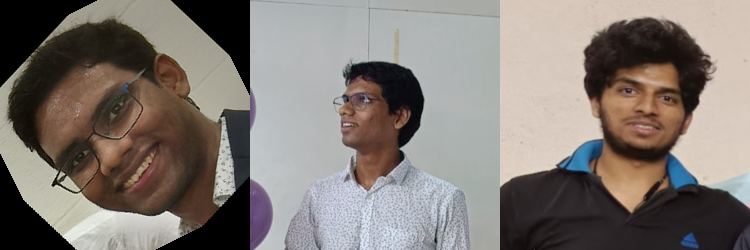

(250, 750, 3)


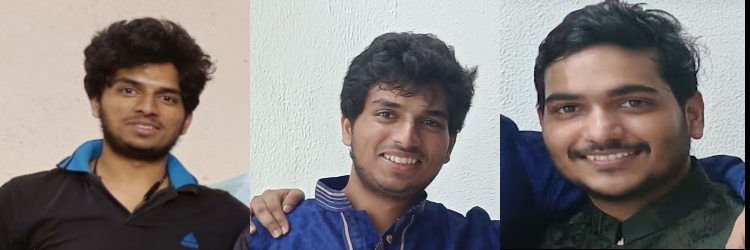

(250, 750, 3)


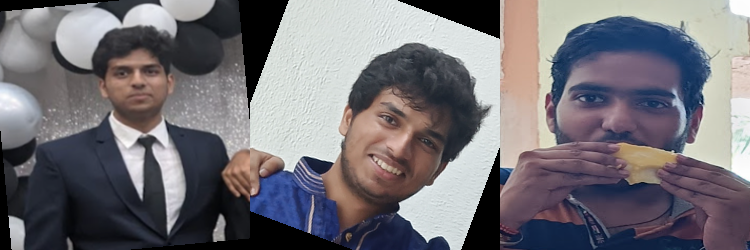

(250, 750, 3)


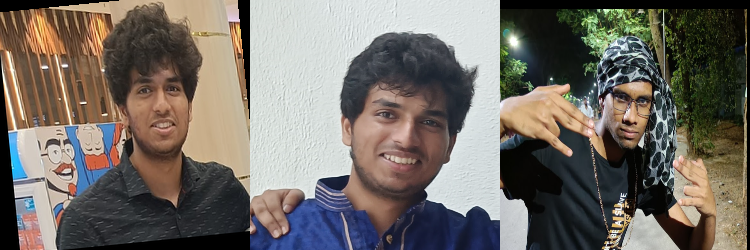

In [ ]:
def Im_show(a, p, n):
    images = [] # Defining a list of images
    images.append(img_augmentation(my_read_image(a))) # appending the augmented anchor image
    images.append(img_augmentation(my_read_image(p))) # appending the augmented postive image
    images.append(img_augmentation(my_read_image(n))) # appending the augmented negative image
    # as before extracting the widths and heights
    widths, heights = zip(*(i.shape[:2] for i in images))
    # Defining the parameters for the final image
    total_width = sum(widths)
    max_height = max(heights)
    # Initializng the final image
    new_im = np.zeros((max_height, total_width, 3), dtype=np.uint8)
    # Similar to the function defined before
    x_offset = 0
    for im in images:
        new_im[:, x_offset:x_offset+im.shape[1], :] = im
        x_offset += im.shape[1]

    return new_im
# Looping over Four random samples and printing their shapes for sanity check
for i in range(4):
    a, p, n = Test_triplet[i + 9]
    img = Im_show(a, p, n)
    print(img.shape)
    cv2_imshow(img)

Now let's test our model on this dataset.

In [ ]:
batch_size = 4
acc = my_test_on_triplets_final(batch_size=batch_size)

1/1 [==============================] - 0s 30ms/step
Accuracy on test = 0.57143


We observe a steep decrease in the accuracy of the model. This can be due to the following reasons:

- Change in camera (Domain) would lead to a different inherent bias to the dataset. Which the model that we trained never knew about.

- The images were not in as simple as before as I have intentionally chosen images with varied features.

# **Part - B**

## Importing the libraries

In [ ]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


## Defining some inputs
Lets define some inputs for the run:

- `dataroot` - the path to the root of the dataset folder. We will talk more about the dataset in the next section.

- `workers` - the number of worker threads for loading the data with the `Dataloader`.

- `batch_size` - the batch size used in training. The GAN we will set it's default value to be 128.

- `image_size` - the spatial size od hte image used for training. This implemtation defaults to 250x250.

- `nc` - number of color channels in the input images. For our case this will be 3

- `nz` - length of the latent vector (Essentially a random vector or noise vector sampled from a simple probability distribustion. This vector is used for synthetic data generation)

- `ngf` - relates to the depth of feature maps carried through the generator.

- `ndf` - sets the depth of feature maps propagated through the discriminator.

- `num_epochs` - number of training epochs to run.

- `lr` - Learning rateof training.

- `beta1` - beta1 hyperparameter for Adam optimizers. As described in paper, this number should be 0.5.

- `ngpu` - number of GPUs available. If this is 0, code will run in CPU mode.

In [ ]:
# Root directory for dataset
dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

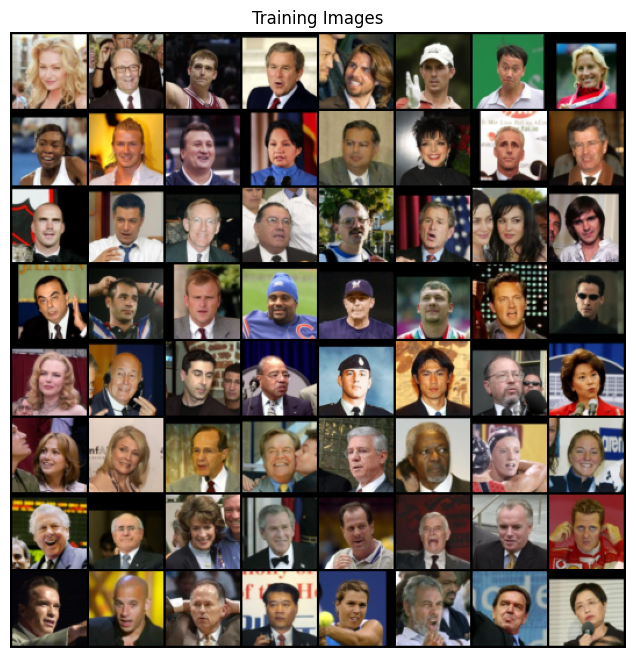

In [ ]:
import torchvision.datasets as dset
import torchvision.transforms as transforms

# Set the root directory to your parent folder containing named subfolders
dataroot = '/content/lfw'  # Replace with your actual parent folder path

# Modify the transform as needed
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

# Create the dataset from the parent folder containing subfolders
dataset = dset.ImageFolder(root=dataroot, transform=transform)

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Implementation
Since we have initialized the input parameters and the dataset. Now we can decide the weights of the model. We will be initializing the weights randomly with the distribution as `mean=0`, `stdev=0.02`. The function below takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. We will apply it on the model right after their initialization.

In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
The generator, ***G***, is designed to map the latent space vector (z) to the data-space. Since our data are images, converting z to data-space means ultimately creating a RGB image with the same size as the training images.

Here `nz`, `ngf`, and `nc` influence the generator architecture in code. `nz` is the length of the z input vector, `ngf` relats to the size of t he feature maps that are propagated through the generator, and `nc` is the nymber of channels in the output image which will be 3 for out case.

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

We can instantiate the generator and apply the function we created before `weights_init`.

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator
The discriminator, ***D***, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real or not.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),

            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Similar to as we did with generator we will initilize randoms weights for the discriminator as well.

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Function and Optimizers
With ***D*** and ***G*** setup, we can specifiy how they learn through the loss functions and optimizers. We will use the Binary Cross Entropy loss function which is defined in PyTorch as:

$$l(x, y) = L = [l_{1},...,l_{N}]^{T},~~
l_{n} = -[y_{n}.logx_{n} + (1-y_{n}).log(1-x_{n})]$$

Next, we define our real label as 1 and the fake label as 0. These labels will be used when calculating the losses of ***D*** and ***G***, finally we set separate optimizers one for ***D*** and one for ***G***.

In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

## Training
Finally, now we have all of the parts of the GAN framework defined, we can train it. We will have to choose the hyperparameters while being mindful such that mode collapse does not occur while following Algorithm 1 discussed in this [Goodfellow's paper](https://proceedings.neurips.cc/paper_files/paper/2014/file/5ca3e9b122f61f8f06494c97b1afccf3-Paper.pdf). While abiding by some best practices mentioned in [ganhacks](https://github.com/soumith/ganhacks). We will construct different mini-batches for real and fake images, and also adjust G's objective function to maximize *log(D(G(Z)))*. We will be training the model in two steps first Discriminator and then Generator.

**Train the Discriminator**

We want to maximize the probability of correctly classifying a given input as real or fake. As we wish to update the dircriminator by ascending its stochastic gradiesnt. First we will construct a batch of real samples from the training set, forward pass through ***D***, Calculate this in two steps. First, we will construct a batch of real samples from the training set, forward pass through ***D***, calculate the loss (*log(1-D(G(z)))*), and accumulate the gradients with a backward pass. now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the discriminator's optimizer.

**Train the Generator**

We want to minimize the *los(1 - D(G(Z)))* in an effort to generate better fakes or we can maximize *log(D(G(z)))*. In the code we accomplish this by: classifying the Generator output from Part1 with the Discriminator, computing G's loss using real labels as GT(Ground Truth), computing G's gradients in a backward pass, and finally updating G's parameters with an optimizer step. It may seem counter-intuitive to use the real labels as GT for the loss function, but this allows us to use the log(x) part of the `BCELoss` (rather than the log(1-x) part) which is exactly what we wanted.

At the end of each epoch we will push our fixed_noise batch through the generator to visually track the progress of G's training. The training statistics reported are:

- **Loss_D** - The loss calculated from the discriminator when checked against real and fake images using `BCELoss`

- **Loss_G** - Generator loss calculated as *log(D(G(z)))*

- **D(x)** - The average output (across the batch) of the discriminator for the all real batch. This should start close to 1 then theoretically converge to 0.5 when G gets better.

- **D(G(z))** - average discriminator outputs for the all fake batch. The first number is before D is updated and second number is after D is updated. These numbers should start near 0 and converge to 0.5 as G gets better.

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/104]	Loss_D: 1.7674	Loss_G: 5.2527	D(x): 0.5087	D(G(z)): 0.5501 / 0.0085
[0/100][50/104]	Loss_D: 1.3775	Loss_G: 18.1421	D(x): 0.9807	D(G(z)): 0.5469 / 0.0000
[0/100][100/104]	Loss_D: 1.0506	Loss_G: 12.9669	D(x): 0.5905	D(G(z)): 0.0001 / 0.0000
[1/100][0/104]	Loss_D: 0.3541	Loss_G: 8.9248	D(x): 0.8345	D(G(z)): 0.0013 / 0.0006
[1/100][50/104]	Loss_D: 1.8738	Loss_G: 4.9188	D(x): 0.3983	D(G(z)): 0.0081 / 0.0133
[1/100][100/104]	Loss_D: 4.1399	Loss_G: 11.3695	D(x): 0.1271	D(G(z)): 0.0000 / 0.0001
[2/100][0/104]	Loss_D: 0.8320	Loss_G: 3.4236	D(x): 0.7119	D(G(z)): 0.1877 / 0.0675
[2/100][50/104]	Loss_D: 0.2923	Loss_G: 4.7812	D(x): 0.8436	D(G(z)): 0.0633 / 0.0158
[2/100][100/104]	Loss_D: 0.3964	Loss_G: 3.3434	D(x): 0.8062	D(G(z)): 0.0952 / 0.0564
[3/100][0/104]	Loss_D: 1.6348	Loss_G: 3.5679	D(x): 0.3249	D(G(z)): 0.0030 / 0.0594
[3/100][50/104]	Loss_D: 0.8404	Loss_G: 5.4907	D(x): 0.8437	D(G(z)): 0.3889 / 0.0118
[3/100][100/104]	Loss_D: 0.4818	Loss_G: 5.7024	D

## Results

Finally, lets check the performance of the model. We will be looking at three different results. Firstly, we will see how D and G's losses changed during training. Secondly, we will visualize G's output on the fixed_noise batch for every epoch. Ans third, we will look at a batch of real next to a batch of fake data from G.

**Loss versus training iteration**

Below is the plot of D & G's losses versus iteration.

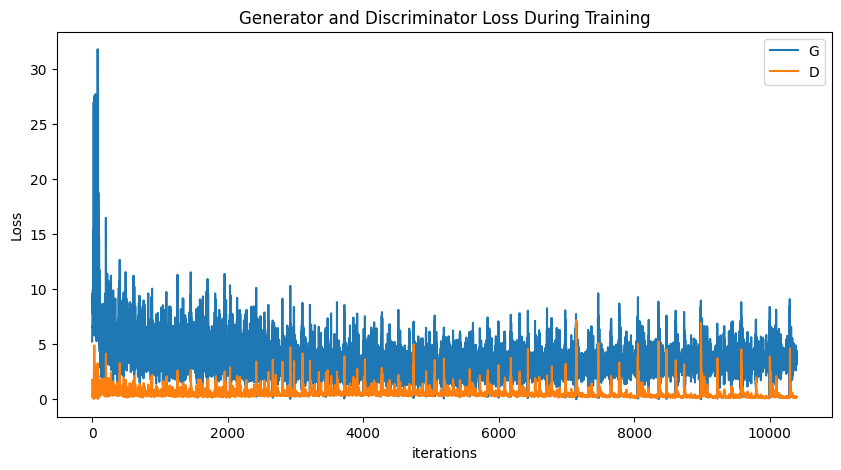

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G's progression**

As we were saving the noise output on fixed_noise batch after every epoch of training. Now, we can visualize the training progression of G with an animation.

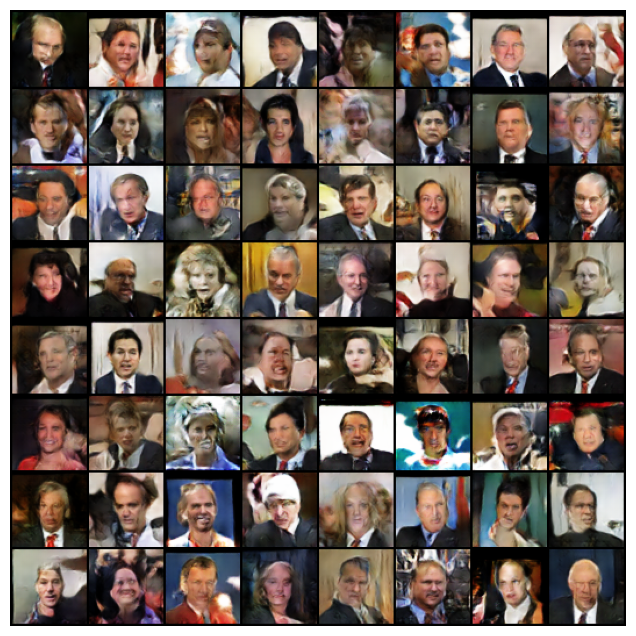

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs Fake Images**

Finally, lets take a look at some real images next to fake images

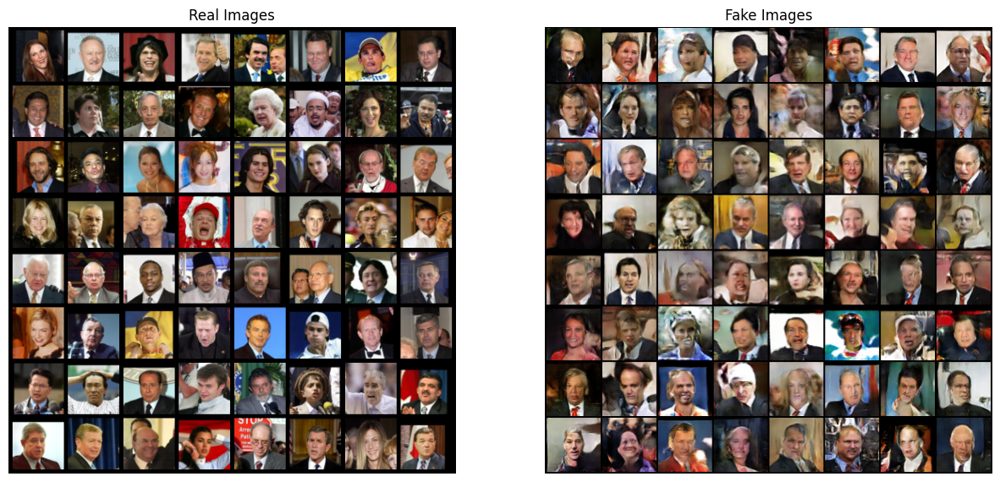

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

# Reference:

[1] https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html

[2] https://github.com/sohaib023/siamese-pytorch

[3] https://www.kaggle.com/code/kmader/image-similarity-with-siamese-networks

[4] https://www.kaggle.com/code/jiangstein/a-very-simple-siamese-network-in-pytorch/comments

[5] https://www.kaggle.com/code/stoicstatic/face-recognition-siamese-w-triplet-loss/notebook

[6] http://github.com/fany02656/Typicality_project

[7] https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

[8] https://github.com/soumith/ganhacks

[9] https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf

[10] https://github.com/pytorch/examples/issues/70